<a href="https://colab.research.google.com/github/louise17300/embedded_AI/blob/main/esca_dataset_augmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Data augmentation for Esca dataset**

---



# STEP 1 - Download dataset from Mendeley repository

In [2]:
dataset_name = "esca_dataset"
# Url to repo (repo temporary saved in Google Drive but intended to Mendeley repo)
dataset_url =  "https://prod-dcd-datasets-cache-zipfiles.s3.eu-west-1.amazonaws.com/89cnxc58kj-1.zip"   # Google Drive -> to change with Mendely Link
# Trick to use wget with gDrive: use 'https://docs.google.com/uc?export=download&id=FILEID'  
# where FILEID is extracted from the virtual link provided from Google drive
dataset_url4wget = "https://docs.google.com/uc?export=download&id=1qO997Wy5drvRpVbAOCL20w82FEGiDpmV"
# Download the archive directly from url
!wget -r --no-check-certificate "$dataset_url" -O $dataset_name".zip"
!ls
# Unzip data
!unzip  $dataset_name".zip"
!ls

will be placed in the single file you specified.

--2022-09-26 12:15:21--  https://prod-dcd-datasets-cache-zipfiles.s3.eu-west-1.amazonaws.com/89cnxc58kj-1.zip
Resolving prod-dcd-datasets-cache-zipfiles.s3.eu-west-1.amazonaws.com (prod-dcd-datasets-cache-zipfiles.s3.eu-west-1.amazonaws.com)... 52.218.25.96
Connecting to prod-dcd-datasets-cache-zipfiles.s3.eu-west-1.amazonaws.com (prod-dcd-datasets-cache-zipfiles.s3.eu-west-1.amazonaws.com)|52.218.25.96|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 943561299 (900M) [application/octet-stream]
Saving to: ‘esca_dataset.zip’

esca_dataset.zip    100%[===================>] 899.85M  32.3MB/s    in 35s     

2022-09-26 12:15:57 (25.5 MB/s) - ‘esca_dataset.zip’ saved [943561299/943561299]

FINISHED --2022-09-26 12:15:57--
Total wall clock time: 36s
Downloaded: 1 files, 900M in 35s (25.5 MB/s)
esca_dataset.zip  sample_data
Archive:  esca_dataset.zip
   creating: esca_dataset/
  inflating: esca_dataset/annotations.csv 

# STEP 2 - Data augmentation

In [4]:
# Input pameters choosen by user
# transformation_array -> User can choose what transformations apply simply comment/uncomment (#) the row corresponding to the transformation name.
# enable_show -> User can choose to display (True) or none (False) the transformations applied to original images. Enabling this option, the execution speed will be reduced.

transformation_array = [
                        "horizontalFlip",
                        "verticalFlip", 
                        "rotation", 
                        "widthShift", 
                        "heightShift",  
                        "shearRange",
                        "zoom", 
                        "blur",
                        "brightness", 
                        "contrast",
                        "saturation",
                        "hue",
                        "gamma"
                        ];
enable_show = False;

In [5]:
# The new dataset 'augmented_esca_dataset' will be created.
# This dataset contains the augmented images create by the ImageGenerator class and the orginal images, 
# in order to obtain an expanded version of the orginal dataset ready-to-use

from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img 
import tensorflow as tf
import os
from numpy import expand_dims
import cv2
import matplotlib.pyplot as plt
from pathlib import Path



def blur(img):
    return (cv2.blur(img,(30,30)))

def horizontal_flip(img):
    return (tf.image.flip_left_right(img))

def vertical_flip(img):
    return (tf.image.flip_up_down(img))
 
def contrast(img):
    return (tf.image.adjust_contrast(img, 0.5))

def saturation(img):
    return (tf.image.adjust_saturation(img, 3))

def hue(img):
    return (tf.image.adjust_hue(img, 0.1)) 

def gamma(img):
    return (tf.image.adjust_gamma(img, 2))



new_dataset = 'augmented_esca_dataset'
classes = ['esca', 'healthy']
for class_tag in classes:
  input_path = '/content/' + dataset_name + '/' + class_tag + '/'
  output_path = '/content/' + dataset_name + '/' + new_dataset + '/' + class_tag + '/'
  print(input_path)
  print(output_path)
  # TMP
  !rm -rf $output_path
  # END TMP
  try:
    if not os.path.exists(output_path):
      os.makedirs(output_path)
  except OSError:
      print ("Creation of the directory %s failed\n\n" % output_path)
  else:
      print ("Successfully created the directory %s\n\n" % output_path)

  for filename in os.listdir(input_path):
    if filename.endswith(".jpg"):
      # Copy the original image in the new dataset
      original_file_path = input_path + filename
      original_newname_file_path = output_path + Path(filename).stem + "_original.jpg"
      %cp $original_file_path $original_newname_file_path
      # Initialising the ImageDataGenerator class. 
      # We will pass in the augmentation parameters in the constructor. 
      for transformation in transformation_array:
        if transformation == "horizontalFlip":
              #datagen = ImageDataGenerator(horizontal_flip = True)                 # for random flip
              datagen = ImageDataGenerator(preprocessing_function=horizontal_flip)  # all imgs flipped
        elif transformation == "verticalFlip":
              #datagen = ImageDataGenerator(vertical_flip = True)                   # for random flip
              datagen = ImageDataGenerator(preprocessing_function=vertical_flip)    # all imgs flipped
        elif transformation == "rotation":
              datagen = ImageDataGenerator(rotation_range = 40, fill_mode='nearest') 
        elif transformation == "widthShift":
              datagen = ImageDataGenerator(width_shift_range = 0.2, fill_mode='nearest')
        elif transformation == "heightShift":
              datagen = ImageDataGenerator(height_shift_range = 0.2, fill_mode='nearest')         
        elif transformation == "shearRange":
              datagen = ImageDataGenerator(shear_range = 0.2)   
        elif transformation == "zoom":
              datagen = ImageDataGenerator(zoom_range = [0.5, 1.0])
        elif transformation == "blur":
              datagen = ImageDataGenerator(preprocessing_function=blur)        
        elif transformation == "brightness":
              #Values less than 1.0 darken the image, e.g. [0.5, 1.0], 
              #whereas values larger than 1.0 brighten the image, e.g. [1.0, 1.5], 
              #where 1.0 has no effect on brightness.
              datagen = ImageDataGenerator(brightness_range = [1.1, 1.5])
        elif transformation == "contrast": 
              datagen = ImageDataGenerator(preprocessing_function=contrast)
        elif transformation == "saturation": 
              datagen = ImageDataGenerator(preprocessing_function=saturation)      
        elif transformation == "hue": 
              datagen = ImageDataGenerator(preprocessing_function=hue)    
        elif transformation == "gamma": 
              datagen = ImageDataGenerator(preprocessing_function=gamma)      

        # Loading a sample image 
        img = load_img(input_path + filename) 
        # Converting the input sample image to an array 
        data = img_to_array(img) 
        # Reshaping the input image expand dimension to one sample
        samples = expand_dims(data, 0) 
        # Plot original image
        print("Original image:")
        print(filename)
        if enable_show:
          plt.imshow(img)
          plt.show()
          print("\n\n")

        # Generating and saving n_augmented_images augmented samples
        print("Apply " + transformation + ".")
        # prepare iterator
        it = datagen.flow(samples, batch_size = 1, 
                    save_to_dir = output_path, 
                    save_prefix = Path(filename).stem + "_" + transformation,
                    save_format ='jpg')
        batch = it.next()
        # Plot trasnformed image
        image = batch[0].astype('uint8')
        if enable_show:
          print("Transformed image:")
          plt.imshow(image)
          plt.show()
        print("\n\n")

print("Done!\n\n")

Streaming output truncated to the last 5000 lines.
healthy_719_cam3.jpg
Apply gamma.



Original image:
healthy_402_cam3.jpg
Apply horizontalFlip.



Original image:
healthy_402_cam3.jpg
Apply verticalFlip.



Original image:
healthy_402_cam3.jpg
Apply rotation.



Original image:
healthy_402_cam3.jpg
Apply widthShift.



Original image:
healthy_402_cam3.jpg
Apply heightShift.



Original image:
healthy_402_cam3.jpg
Apply shearRange.



Original image:
healthy_402_cam3.jpg
Apply zoom.



Original image:
healthy_402_cam3.jpg
Apply blur.



Original image:
healthy_402_cam3.jpg
Apply brightness.



Original image:
healthy_402_cam3.jpg
Apply contrast.



Original image:
healthy_402_cam3.jpg
Apply saturation.



Original image:
healthy_402_cam3.jpg
Apply hue.



Original image:
healthy_402_cam3.jpg
Apply gamma.



Original image:
healthy_676_cam3.jpg
Apply horizontalFlip.



Original image:
healthy_676_cam3.jpg
Apply verticalFlip.



Original image:
healthy_676_cam3.jpg
Apply rotation.



O

# [Opzional STEP] - Visualize some images generated from data augmentation

esca_686_cam1.jpg
Augmented images:


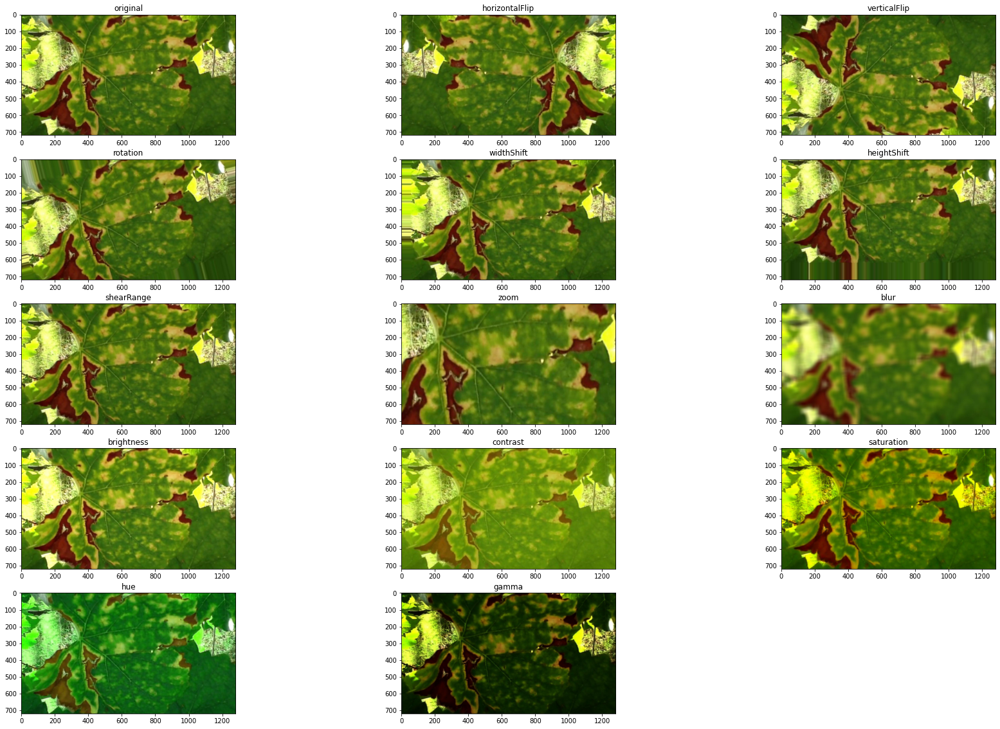




esca_638_cam1.jpg
Augmented images:


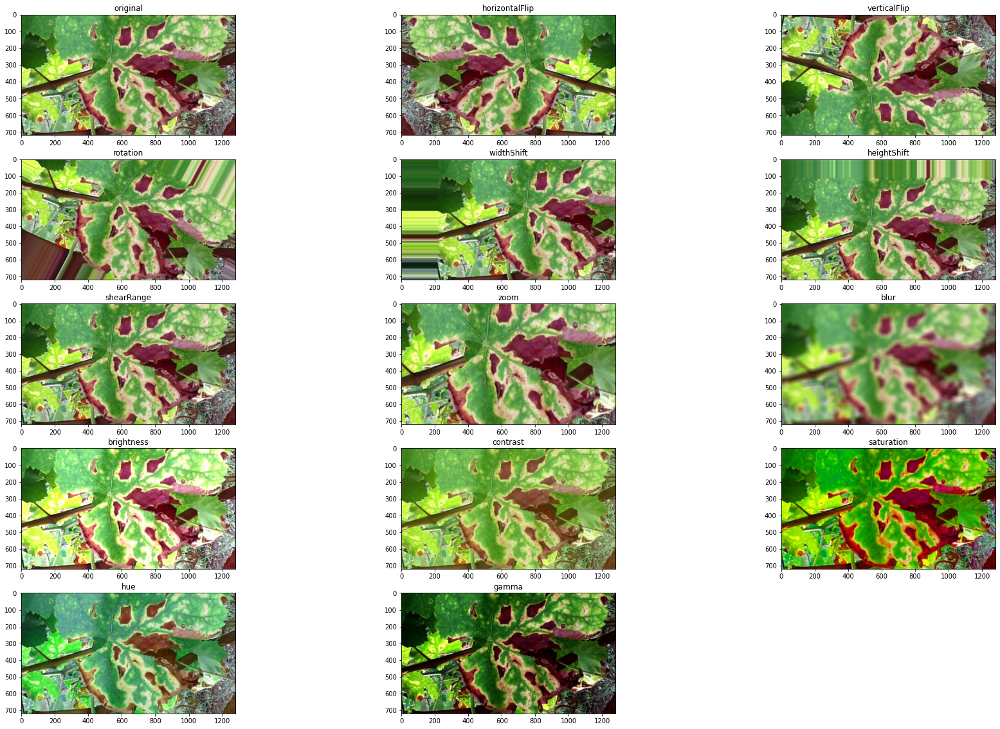




esca_861_cam2.jpg
Augmented images:


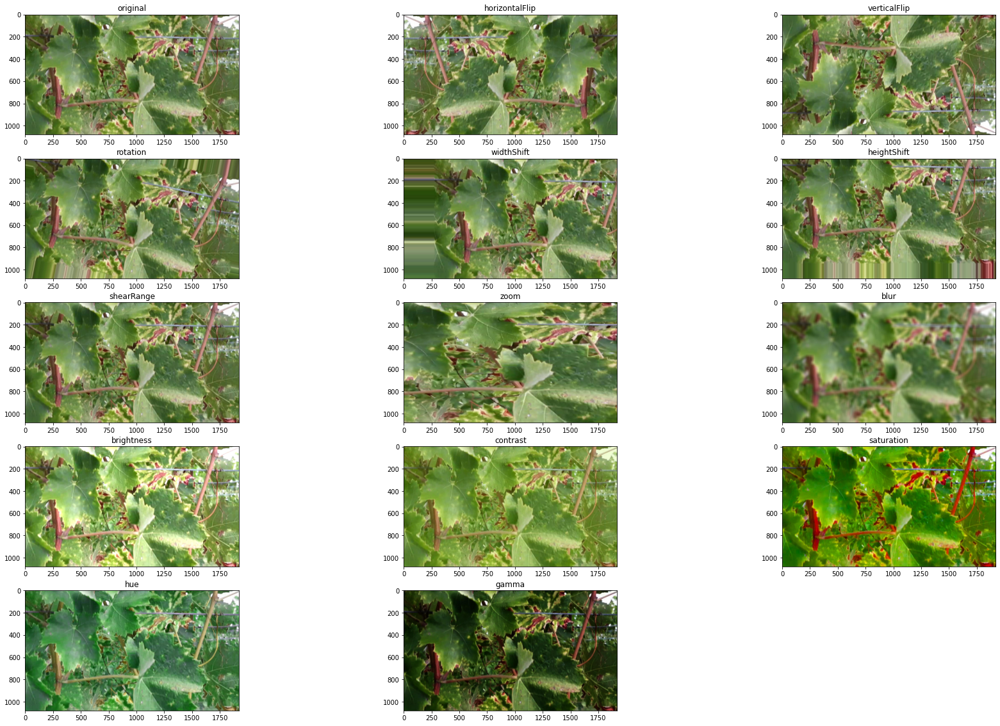




esca_735_cam2.jpg
Augmented images:


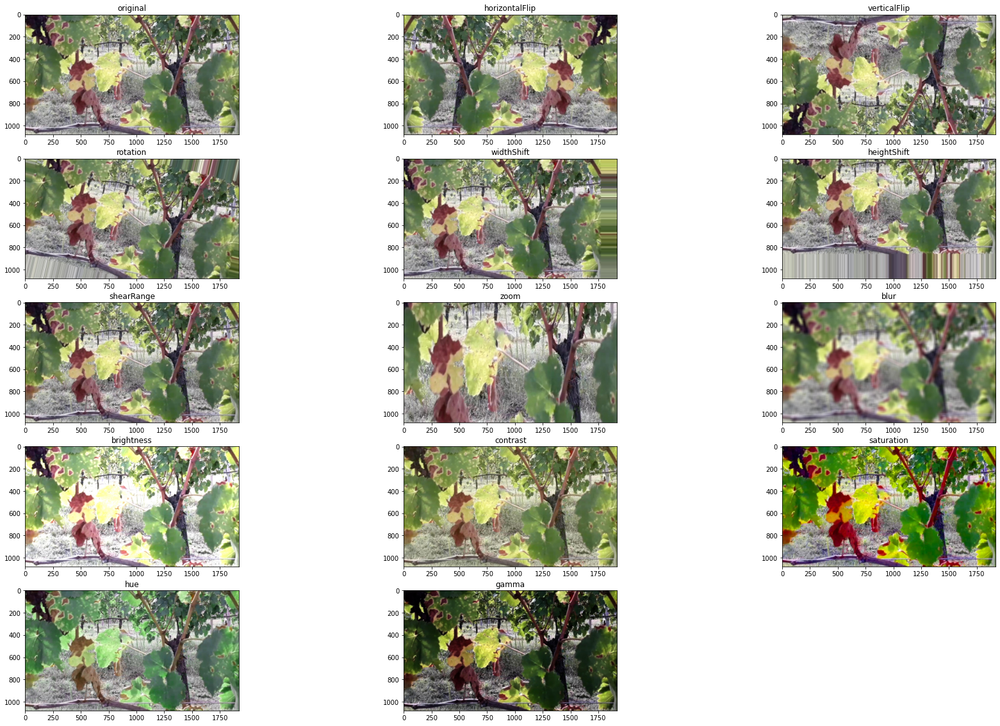




esca_833_cam2.jpg
Augmented images:


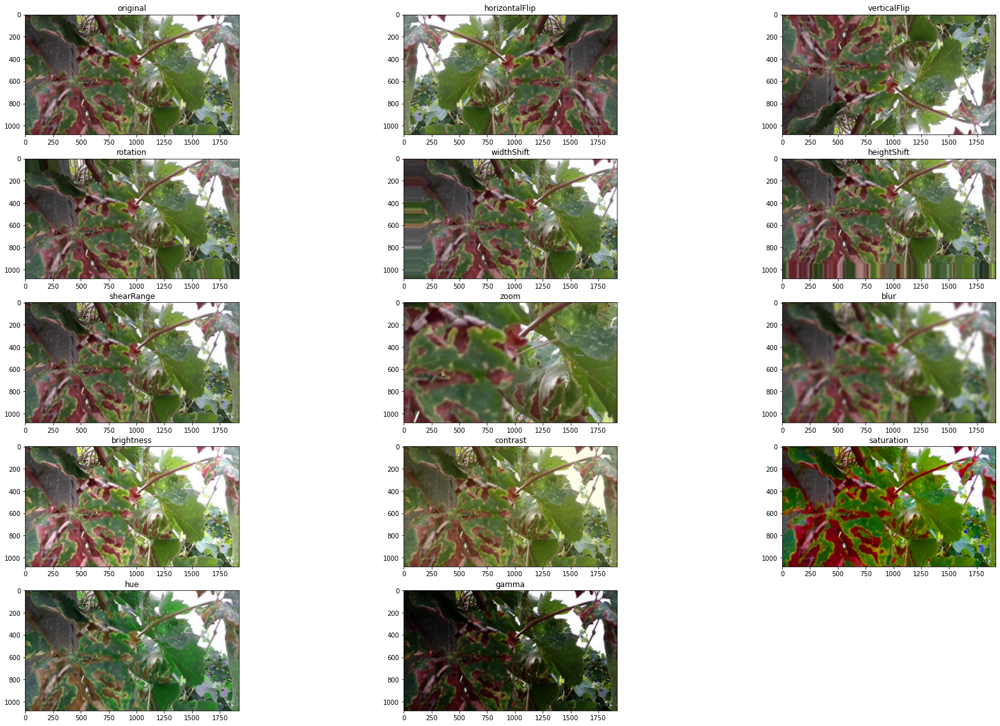




healthy_568_cam3.jpg
Augmented images:


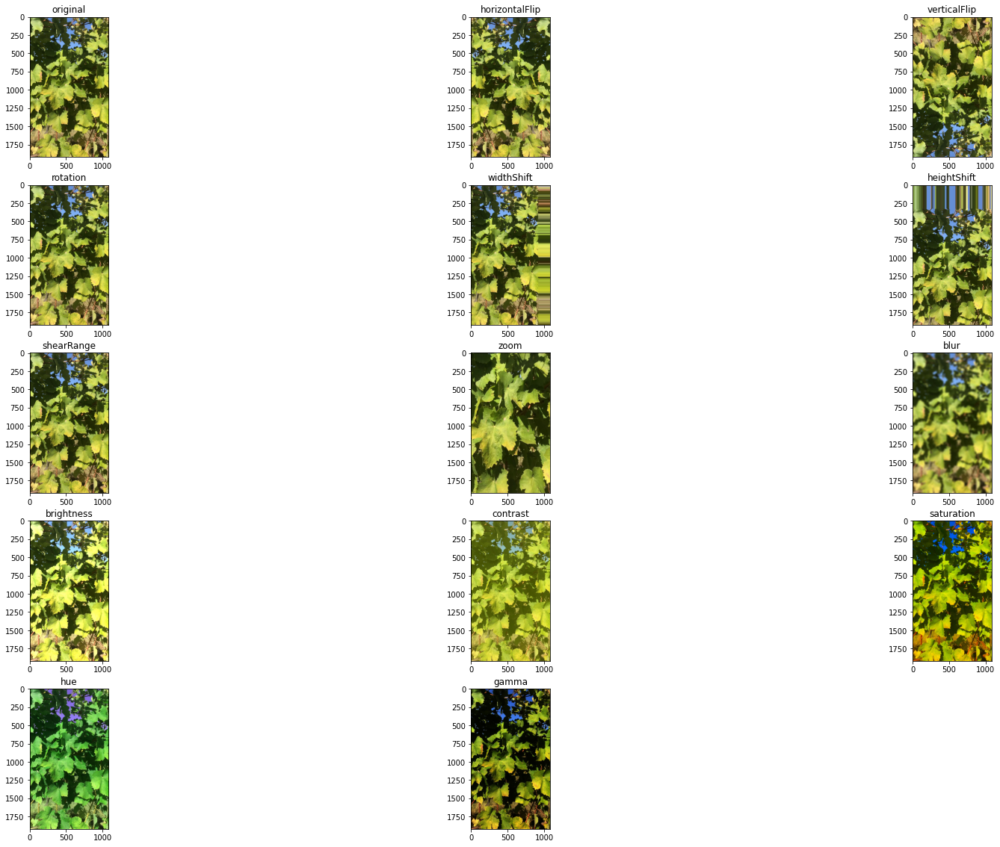




healthy_525_cam3.jpg
Augmented images:


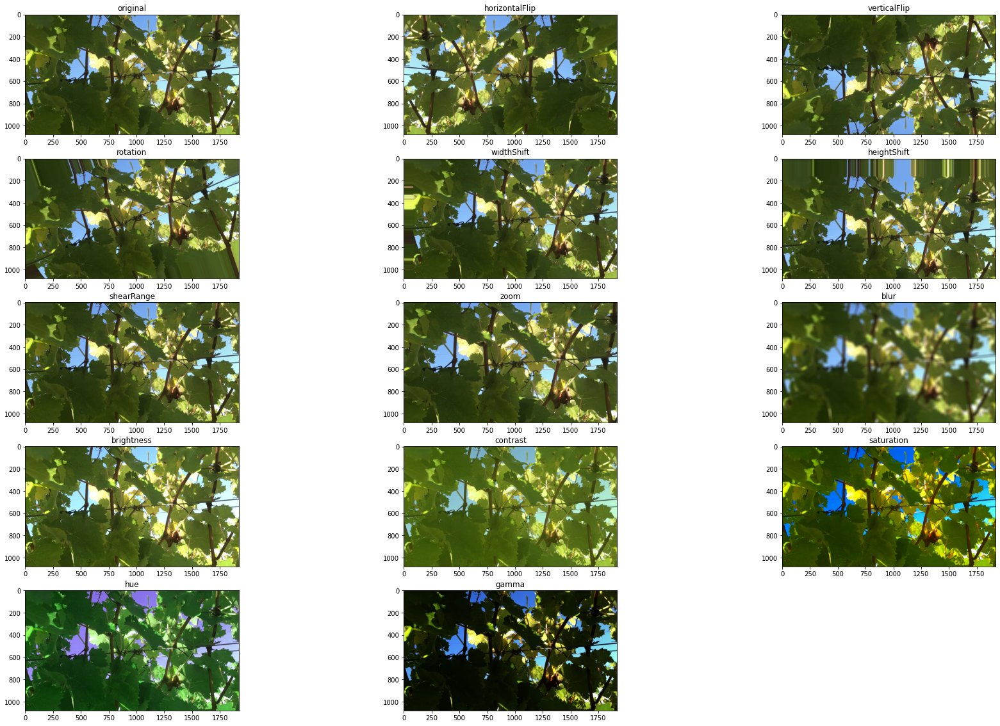




healthy_189_cam3.jpg
Augmented images:


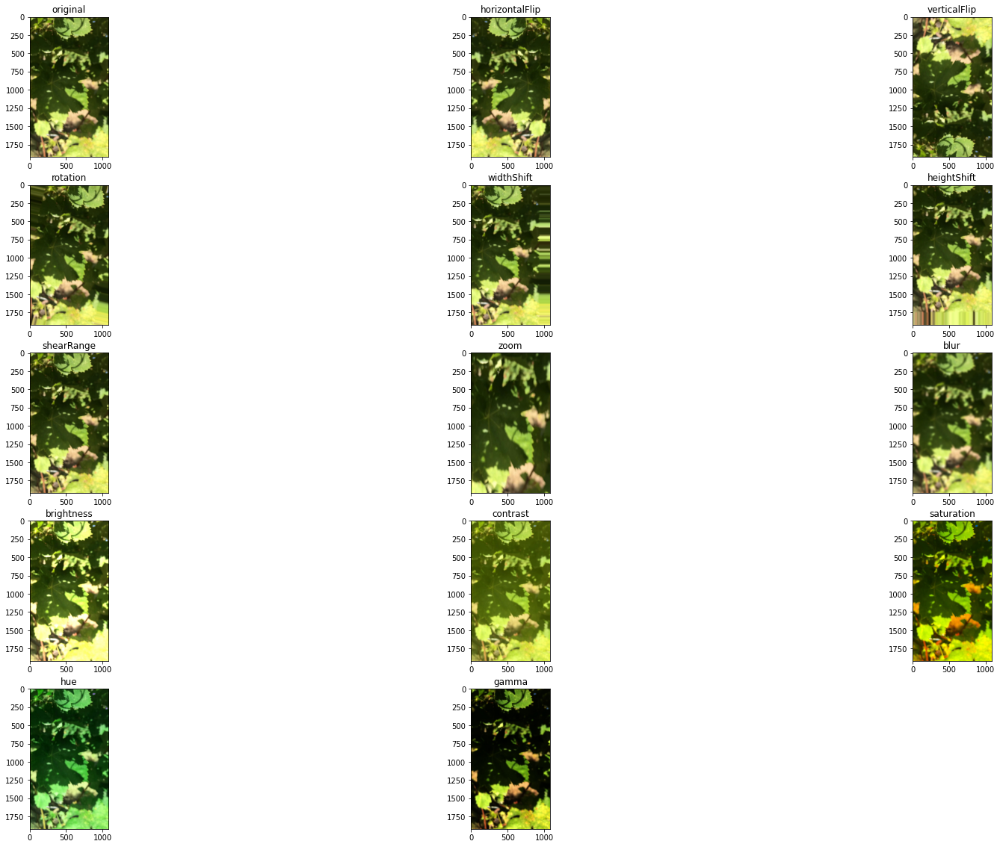




healthy_230_cam3.jpg
Augmented images:


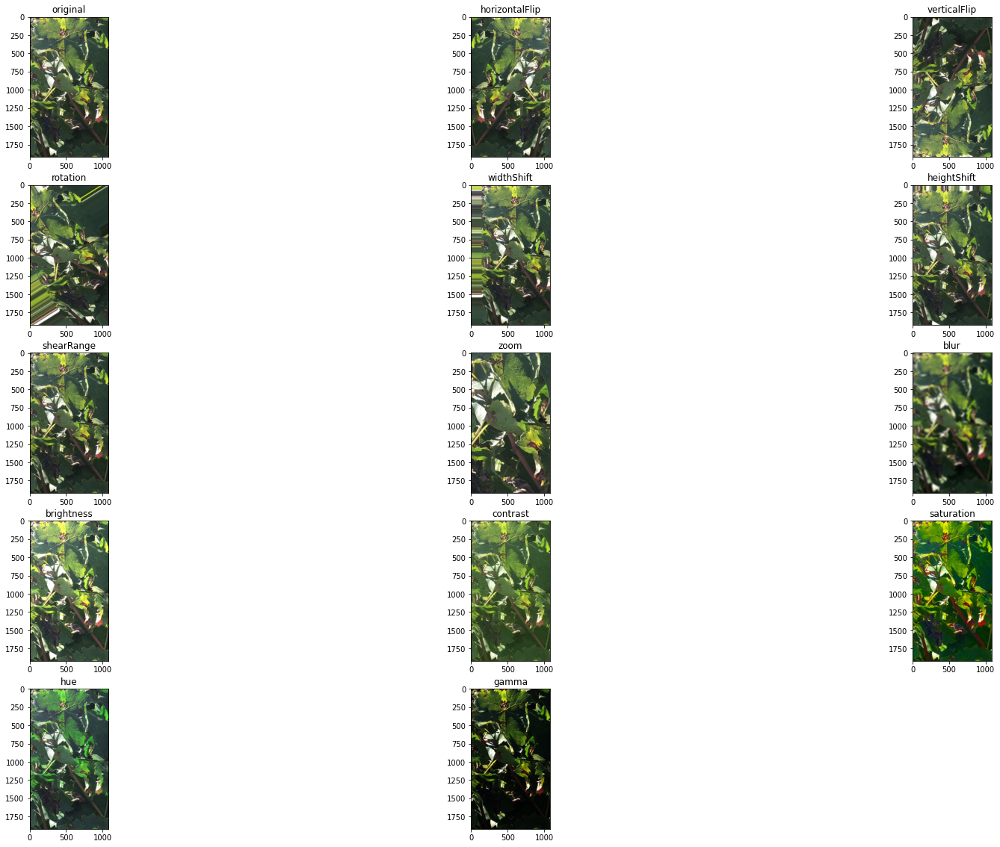




healthy_288_cam3.jpg
Augmented images:


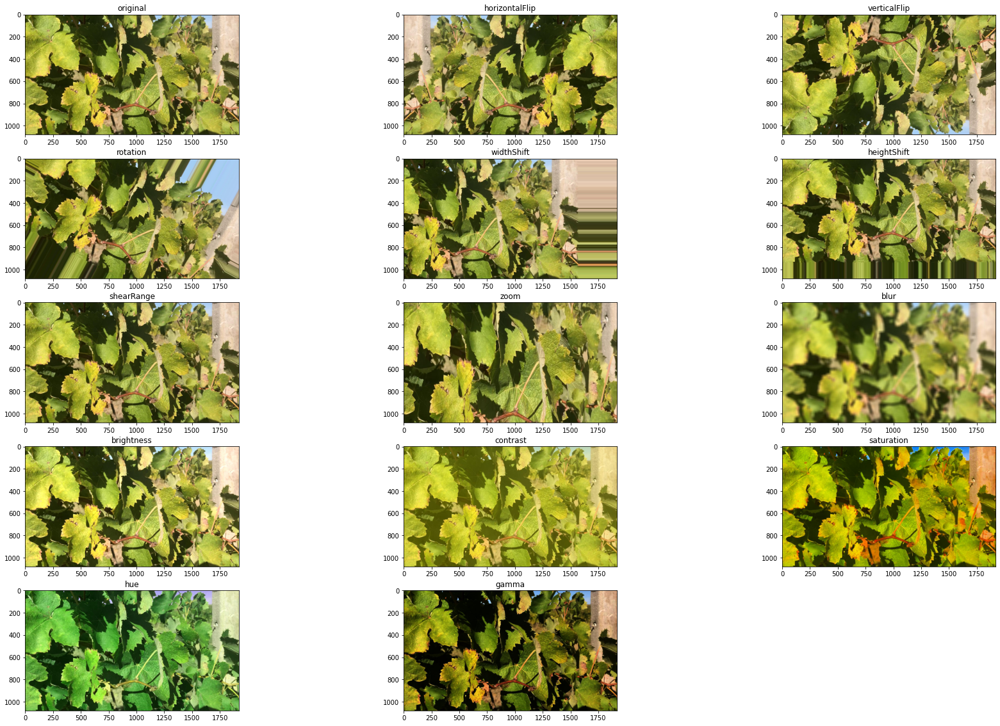

In [6]:
# Visualize N images with data aumentation applied, 
# where N = n_images_shown can be chosen by the user.

import os
import glob
from numpy import expand_dims
import cv2
import matplotlib.pyplot as plt
from pathlib import Path


n_images_shown = 4              # This parameter can be modified by the user

for class_tag in classes:
  input_path = '/content/' + dataset_name + '/' + class_tag + '/'
  output_path = '/content/' + dataset_name + '/' + new_dataset + '/' + class_tag + '/'

  counter = 0
  for filename in os.listdir(input_path):
    if filename.endswith(".jpg"):

      if counter > n_images_shown:
        break

      # Show the obtained AUGMENTATED IMAGES (plus ORIGINAL IMAGE) for the specific orginal image
      print(filename)
      transformation_array_size = len(transformation_array)
      # Define subplot
      fig = plt.figure(figsize=(30,20))
      columns = 3
      rows = transformation_array_size / columns + 1  
      # Sort images by creation date to obtain "original" as first image
      files_sorted = list(filter(os.path.isfile, glob.glob(output_path + Path(filename).stem + "*.jpg")))
      files_sorted.sort(key=lambda x: os.path.getmtime(x))
      #print(files_sorted)
      index = 0
      for filename_out in files_sorted:
        #print(filename_out)
        # Load image
        aug_img = load_img(filename_out) 
        # Converting the input sample image to an array 
        data = img_to_array(aug_img) 
        # Reshaping the input image expand dimension to one sample
        samples = expand_dims(data, 0) 
        # Plot augmented image
        ax1 = fig.add_subplot(rows, columns, index + 1)
        ax1.title.set_text((Path(filename_out).stem).split('_')[3])
        plt.imshow(aug_img)
        index = index + 1
      print("Augmented images:")
      plt.show()
      print("\n\n")
    counter = counter + 1
    


# Step 3 - Save augmented dataset

In [7]:
#@title Save your data to Google drive
filename = "augmented_esca_dataset" #@param {type:"string"}
folders_to_save = "/content/esca_dataset/augmented_esca_dataset" #@param {type:"string"}

from google.colab import files
from google.colab import auth
from googleapiclient.http import MediaFileUpload
from googleapiclient.discovery import build


def save_file_to_drive(name, path):
    file_metadata = {
    'name': name,
    'mimeType': 'application/octet-stream'
    }
    media = MediaFileUpload(path, 
                  mimetype='application/octet-stream',
                  resumable=True)
    created = drive_service.files().create(body=file_metadata, media_body=media, fields='id').execute()
    print('File ID: {}'.format(created.get('id')))
    return created


# Create archive
extension_zip = ".zip"
zip_file = filename + extension_zip
!zip -r $zip_file {folders_to_save}

# Save archive to your Google Drive
auth.authenticate_user()
drive_service = build('drive', 'v3')
destination_name = zip_file
path_to_file = zip_file
save_file_to_drive(destination_name, path_to_file)
!ls

print("Done!")


Streaming output truncated to the last 5000 lines.
  adding: content/esca_dataset/augmented_esca_dataset/healthy/healthy_200_cam3_gamma_0_1759.jpg (deflated 0%)
  adding: content/esca_dataset/augmented_esca_dataset/healthy/healthy_410_cam3_hue_0_9914.jpg (deflated 0%)
  adding: content/esca_dataset/augmented_esca_dataset/healthy/healthy_072_cam3_brightness_0_5317.jpg (deflated 0%)
  adding: content/esca_dataset/augmented_esca_dataset/healthy/healthy_453_cam3_heightShift_0_9554.jpg (deflated 1%)
  adding: content/esca_dataset/augmented_esca_dataset/healthy/healthy_559_cam3_contrast_0_9234.jpg (deflated 0%)
  adding: content/esca_dataset/augmented_esca_dataset/healthy/healthy_707_cam3_rotation_0_1909.jpg (deflated 1%)
  adding: content/esca_dataset/augmented_esca_dataset/healthy/healthy_328_cam3_original.jpg (deflated 0%)
  adding: content/esca_dataset/augmented_esca_dataset/healthy/healthy_259_cam3_horizontalFlip_0_2629.jpg (deflated 0%)
  adding: content/esca_dataset/augmented_esca_dat

# BACKUP

- EXTRACT DATA FROM ARCHIVE


In [8]:
'''
import zipfile
from google.colab import drive

drive.mount('/content/drive/')
!ls

zip_ref = zipfile.ZipFile("/content/drive/My Drive/Colab Notebooks/esca_dataset.zip", 'r')
zip_ref.extractall("/content/drive/My Drive/Colab Notebooks/esca_dataset")
zip_ref.close()
'''

'\nimport zipfile\nfrom google.colab import drive\n\ndrive.mount(\'/content/drive/\')\n!ls\n\nzip_ref = zipfile.ZipFile("/content/drive/My Drive/Colab Notebooks/esca_dataset.zip", \'r\')\nzip_ref.extractall("/content/drive/My Drive/Colab Notebooks/esca_dataset")\nzip_ref.close()\n'

- ARCHIVE DATA AND SAVE ZIP FILE TO YOUR PC

In [9]:
'''
# An archive file of the augmented dataset will be created 
# and automatically downloaded to the path selected by the user in the browse window that will appear at the end of the script

from google.colab import files
import requests
from multiprocessing.pool import ThreadPool
from pathlib import Path


# Create archive
data_folder_tozip = "/content/" + dataset_name + "/" + new_dataset
archive_name = new_dataset + ".zip"
print(data_folder_tozip)

#!zip -r $archive_name $data_folder_tozip
#files.download(archive_name)

# We have a large archive, so we create a split zip archive, that is multiple archives of the same folder (each part of 100 MB)
!zip -r -s 100m "archive.zip" $data_folder_tozip

# Download the split archive, so we have multiple archives on the chosen path 
def download_archive(archive):
  print("Downloading: ",archive)
  files.download(archive)
 
archive_array = []
for path in Path('/content/').rglob('archive.z*'):
    print(path.name)
    string = path.name
    archive_array.append(string)
print(archive_array)
print(len(archive_array))

# Run multiple threads to download the multiple archives in parallel
ThreadPool(len(archive_array)).imap_unordered(download_archive, archive_array)


# NOTE: After download the multiple archives, the use must reconstruct the archive:
# - For Linux users:
# To unzip the file, first convert a split archive to a single-file archive:
# zip -s 0 archive.zip --out unsplit.zip
# Then you can unzip the "unsplit" file
# unzip unsplit.zip
#
# - For Windows:
# 
'''

'\n# An archive file of the augmented dataset will be created \n# and automatically downloaded to the path selected by the user in the browse window that will appear at the end of the script\n\nfrom google.colab import files\nimport requests\nfrom multiprocessing.pool import ThreadPool\nfrom pathlib import Path\n\n\n# Create archive\ndata_folder_tozip = "/content/" + dataset_name + "/" + new_dataset\narchive_name = new_dataset + ".zip"\nprint(data_folder_tozip)\n\n#!zip -r $archive_name $data_folder_tozip\n#files.download(archive_name)\n\n# We have a large archive, so we create a split zip archive, that is multiple archives of the same folder (each part of 100 MB)\n!zip -r -s 100m "archive.zip" $data_folder_tozip\n\n# Download the split archive, so we have multiple archives on the chosen path \ndef download_archive(archive):\n  print("Downloading: ",archive)\n  files.download(archive)\n \narchive_array = []\nfor path in Path(\'/content/\').rglob(\'archive.z*\'):\n    print(path.name)\n